### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [1]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendras una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

In [2]:

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error
import numpy as np

In [3]:
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


In [4]:
df.columns


Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

In [5]:
df=df.iloc[:,0:6]
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


SACO MI X

In [6]:
X=df.iloc[:,]
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05
...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06


SACO MI y

In [7]:
y=df.iloc[:,-1]
y

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

In [8]:
y=np.array(y)


Recorremos las columnas con un FOR y salen score similares para todas las coñumnas, a partir de grado 5 baja el score 

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.41350271053462095


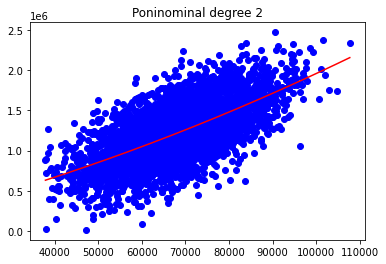

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 1.64921898e+14]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 2.38513443e+14]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 4.84756506e+14]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 2.80128400e+14]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 4.33658861e+14]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 1.56829860e+14]]
(4000, 4)
y_pred (4000,)
Score: 0.41350280292528796


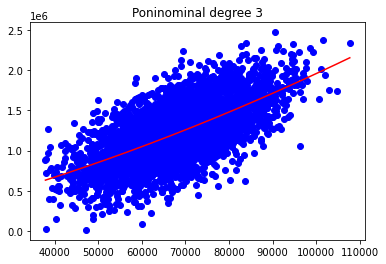

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 1.64921898e+14
  9.04421963e+18]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 2.38513443e+14
  1.47916679e+19]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 4.84756506e+14
  3.80801101e+19]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 2.80128400e+14
  1.83291723e+19]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 4.33658861e+14
  3.28244633e+19]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 1.56829860e+14
  8.45742862e+18]]
(4000, 5)
y_pred (4000,)
Score: 0.41352084960333735


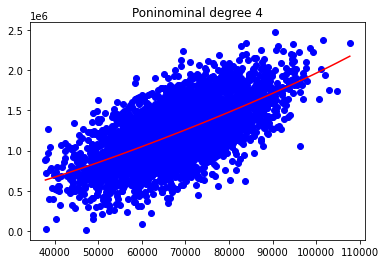

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 1.64921898e+14
  9.04421963e+18 4.95979670e+23]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 2.38513443e+14
  1.47916679e+19 9.17321210e+23]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 4.84756506e+14
  3.80801101e+19 2.99138798e+24]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 2.80128400e+14
  1.83291723e+19 1.19930203e+24]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 4.33658861e+14
  3.28244633e+19 2.48454600e+24]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 1.56829860e+14
  8.45742862e+18 4.56087245e+23]]
(4000, 6)
y_pred (4000,)
Score: 0.41353879025812545


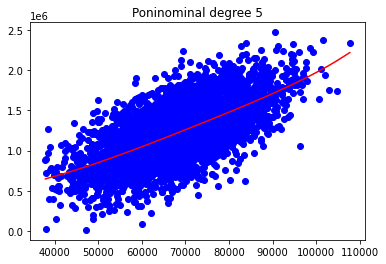

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 ... 9.04421963e+18
  4.95979670e+23 2.71992326e+28]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 ... 1.47916679e+19
  9.17321210e+23 5.68886624e+28]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 ... 3.80801101e+19
  2.99138798e+24 2.34988870e+29]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 ... 1.83291723e+19
  1.19930203e+24 7.84719205e+28]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 ... 3.28244633e+19
  2.48454600e+24 1.88060008e+29]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 ... 8.45742862e+18
  4.56087245e+23 2.45956051e+28]]
(4000, 7)
y_pred (4000,)
Score: 0.41340987465655676


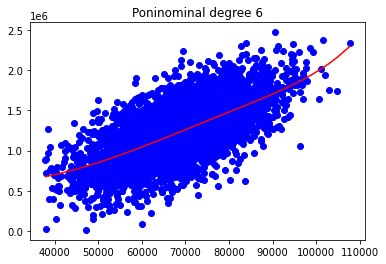

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 ... 4.95979670e+23
  2.71992326e+28 1.49158987e+33]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 ... 9.17321210e+23
  5.68886624e+28 3.52801164e+33]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 ... 2.99138798e+24
  2.34988870e+29 1.84595811e+34]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 ... 1.19930203e+24
  7.84719205e+28 5.13452172e+33]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 ... 2.48454600e+24
  1.88060008e+29 1.42346194e+34]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 ... 4.56087245e+23
  2.45956051e+28 1.32637735e+33]]
(4000, 8)
y_pred (4000,)
Score: 0.4128364226973784


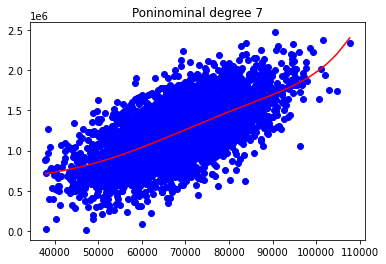

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 ... 2.71992326e+28
  1.49158987e+33 8.17979088e+37]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 ... 5.68886624e+28
  3.52801164e+33 2.18793440e+38]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 ... 2.34988870e+29
  1.84595811e+34 1.45009479e+39]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 ... 7.84719205e+28
  5.13452172e+33 3.35958558e+38]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 ... 1.88060008e+29
  1.42346194e+34 1.07744539e+39]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 ... 2.45956051e+28
  1.32637735e+33 7.15280989e+37]]
(4000, 9)
y_pred (4000,)
Score: 0.4114241810107504


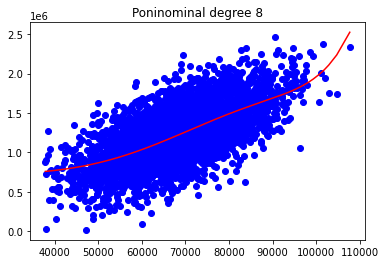

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 ... 1.49158987e+33
  8.17979088e+37 4.48574907e+42]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 ... 3.52801164e+33
  2.18793440e+38 1.35687107e+43]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 ... 1.84595811e+34
  1.45009479e+39 1.13912384e+44]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 ... 5.13452172e+33
  3.35958558e+38 2.19822136e+43]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 ... 1.42346194e+34
  1.07744539e+39 8.15538888e+43]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 ... 1.32637735e+33
  7.15280989e+37 3.85732532e+42]]
(4000, 10)
y_pred (4000,)
Score: 0.40877741302891846


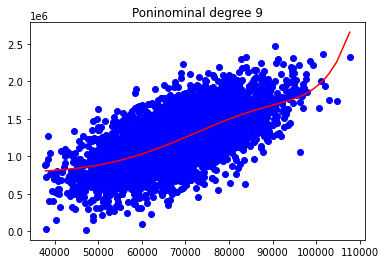

################
[[1.00000000e+00 5.48394102e+04 3.00736091e+09 ... 8.17979088e+37
  4.48574907e+42 2.45995833e+47]
 [1.00000000e+00 6.20160765e+04 3.84599375e+09 ... 2.18793440e+38
  1.35687107e+43 8.41478202e+47]
 [1.00000000e+00 7.85551295e+04 6.17090837e+09 ... 1.45009479e+39
  1.13912384e+44 8.94840206e+48]
 ...
 [1.00000000e+00 6.54313248e+04 4.28125827e+09 ... 3.35958558e+38
  2.19822136e+43 1.43832535e+48]
 [1.00000000e+00 7.56919002e+04 5.72926376e+09 ... 1.07744539e+39
  8.15538888e+43 6.17296882e+48]
 [1.00000000e+00 5.39274128e+04 2.90816585e+09 ... 7.15280989e+37
  3.85732532e+42 2.08015575e+47]]
(4000, 11)
y_pred (4000,)
Score: 0.4045804052525015


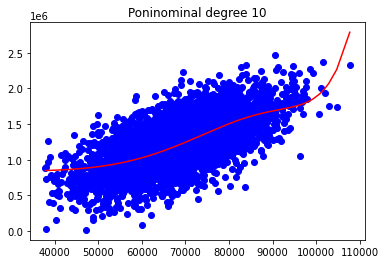

################
[[ 1.          5.2213085  27.26206248]
 [ 1.          7.0062002  49.08684119]
 [ 1.          5.39771898 29.13537021]
 ...
 [ 1.          7.6447786  58.44263981]
 [ 1.          6.37542429 40.64603493]
 [ 1.          5.99064892 35.88787444]]
(4000, 3)
y_pred (4000,)
Score: 0.2105127254302036


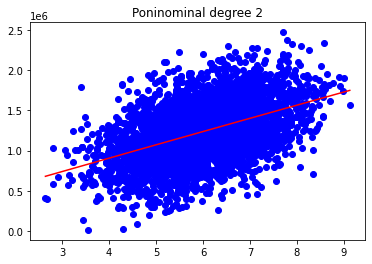

################
[[  1.           5.2213085   27.26206248 142.34363863]
 [  1.           7.0062002   49.08684119 343.91223639]
 [  1.           5.39771898  29.13537021 157.26454083]
 ...
 [  1.           7.6447786   58.44263981 446.78104206]
 [  1.           6.37542429  40.64603493 259.13571859]
 [  1.           5.99064892  35.88787444 214.9916561 ]]
(4000, 4)
y_pred (4000,)
Score: 0.2105923871151475


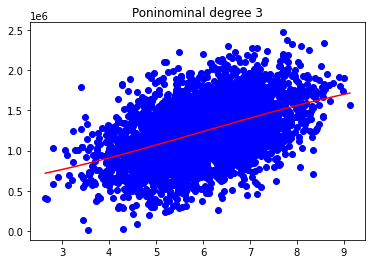

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 1.42343639e+02
  7.43220051e+02]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 3.43912236e+02
  2.40951798e+03]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 1.57264541e+02
  8.48869797e+02]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 4.46781042e+02
  3.41554215e+03]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 2.59135719e+02
  1.65210016e+03]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 2.14991656e+02
  1.28793953e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.2106722078816755


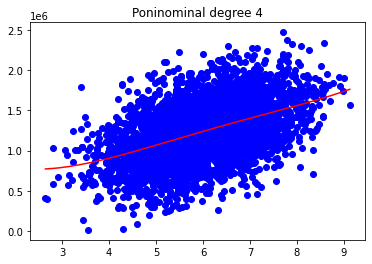

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 1.42343639e+02
  7.43220051e+02 3.88058117e+03]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 3.43912236e+02
  2.40951798e+03 1.68815653e+04]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 1.57264541e+02
  8.48869797e+02 4.58196062e+03]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 4.46781042e+02
  3.41554215e+03 2.61110635e+04]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 2.59135719e+02
  1.65210016e+03 1.05328395e+04]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 2.14991656e+02
  1.28793953e+03 7.71559356e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.2114361287487183


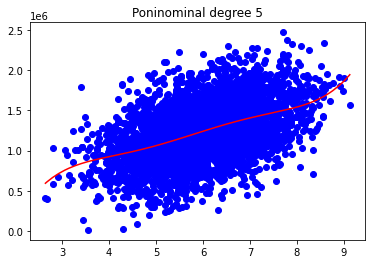

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 ... 7.43220051e+02
  3.88058117e+03 2.02617115e+04]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 ... 2.40951798e+03
  1.68815653e+04 1.18275626e+05]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 ... 8.48869797e+02
  4.58196062e+03 2.47321358e+04]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 ... 3.41554215e+03
  2.61110635e+04 1.99613300e+05]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 ... 1.65210016e+03
  1.05328395e+04 6.71513206e+04]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 ... 1.28793953e+03
  7.71559356e+03 4.62214122e+04]]
(4000, 7)
y_pred (4000,)
Score: 0.21152025583099243


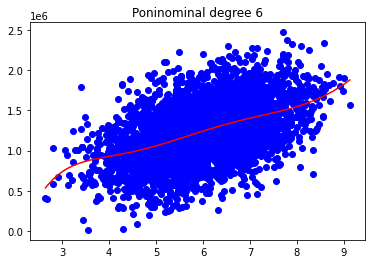

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 ... 3.88058117e+03
  2.02617115e+04 1.05792646e+05]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 ... 1.68815653e+04
  1.18275626e+05 8.28662716e+05]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 ... 4.58196062e+03
  2.47321358e+04 1.33497119e+05]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 ... 2.61110635e+04
  1.99613300e+05 1.52599948e+06]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 ... 1.05328395e+04
  6.71513206e+04 4.28118161e+05]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 ... 7.71559356e+03
  4.62214122e+04 2.76896253e+05]]
(4000, 8)
y_pred (4000,)
Score: 0.21184460232258873


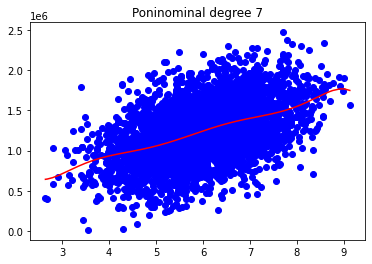

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 ... 2.02617115e+04
  1.05792646e+05 5.52376044e+05]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 ... 1.18275626e+05
  8.28662716e+05 5.80577689e+06]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 ... 2.47321358e+04
  1.33497119e+05 7.20579933e+05]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 ... 1.99613300e+05
  1.52599948e+06 1.16659282e+07]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 ... 6.71513206e+04
  4.28118161e+05 2.72943492e+06]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 ... 4.62214122e+04
  2.76896253e+05 1.65878824e+06]]
(4000, 9)
y_pred (4000,)
Score: 0.21213424938915437


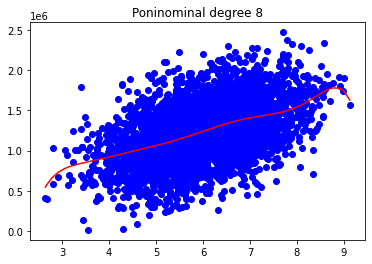

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 ... 1.05792646e+05
  5.52376044e+05 2.88412573e+06]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 ... 8.28662716e+05
  5.80577689e+06 4.06764352e+07]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 ... 1.33497119e+05
  7.20579933e+05 3.88948798e+06]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 ... 1.52599948e+06
  1.16659282e+07 8.91834380e+07]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 ... 4.28118161e+05
  2.72943492e+06 1.74013057e+07]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 ... 2.76896253e+05
  1.65878824e+06 9.93721795e+06]]
(4000, 10)
y_pred (4000,)
Score: 0.2131732080117572


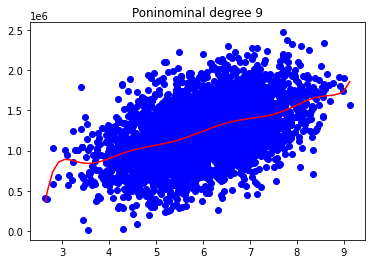

################
[[1.00000000e+00 5.22130850e+00 2.72620625e+01 ... 5.52376044e+05
  2.88412573e+06 1.50589102e+07]
 [1.00000000e+00 7.00620020e+00 4.90868412e+01 ... 5.80577689e+06
  4.06764352e+07 2.84987248e+08]
 [1.00000000e+00 5.39771898e+00 2.91353702e+01 ... 7.20579933e+05
  3.88948798e+06 2.09943631e+07]
 ...
 [1.00000000e+00 7.64477860e+00 5.84426398e+01 ... 1.16659282e+07
  8.91834380e+07 6.81787638e+08]
 [1.00000000e+00 6.37542429e+00 4.06460349e+01 ... 2.72943492e+06
  1.74013057e+07 1.10940707e+08]
 [1.00000000e+00 5.99064892e+00 3.58878744e+01 ... 1.65878824e+06
  9.93721795e+06 5.95303840e+07]]
(4000, 11)
y_pred (4000,)
Score: 0.2132926789649371


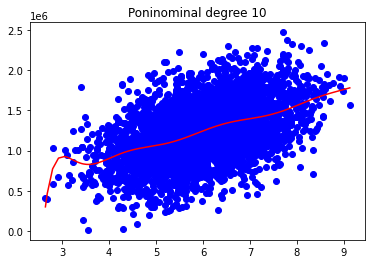

################
[[ 1.          4.67407356 21.84696369]
 [ 1.          4.84059506 23.43136049]
 [ 1.          6.43654196 41.42907236]
 ...
 [ 1.          6.56152022 43.05354755]
 [ 1.          8.21677347 67.5153662 ]
 [ 1.          7.59526393 57.68803409]]
(4000, 3)
y_pred (4000,)
Score: 0.10827168125004483


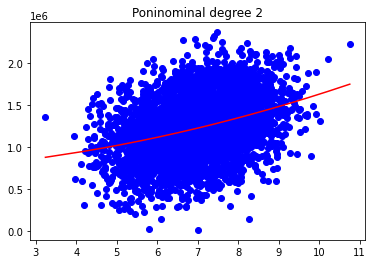

################
[[  1.           4.67407356  21.84696369 102.11431543]
 [  1.           4.84059506  23.43136049 113.42172771]
 [  1.           6.43654196  41.42907236 266.65996244]
 ...
 [  1.           6.56152022  43.05354755 282.4967226 ]
 [  1.           8.21677347  67.5153662  554.75846963]
 [  1.           7.59526393  57.68803409 438.15584427]]
(4000, 4)
y_pred (4000,)
Score: 0.10827176772970659


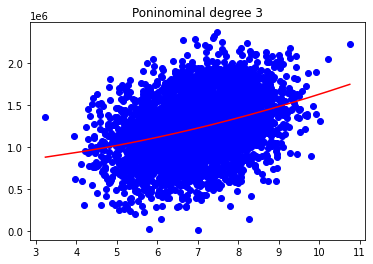

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 1.02114315e+02
  4.77289822e+02]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 1.13421728e+02
  5.49028654e+02]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 2.66659962e+02
  1.71636804e+03]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 2.82496723e+02
  1.85360796e+03]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 5.54758470e+02
  4.55832467e+03]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 4.38155844e+02
  3.32790928e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.10889049498708725


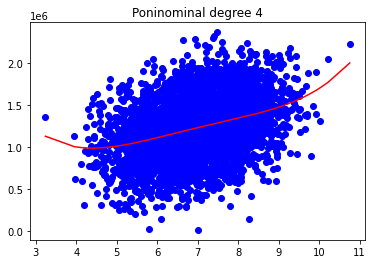

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 1.02114315e+02
  4.77289822e+02 2.23088774e+03]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 1.13421728e+02
  5.49028654e+02 2.65762539e+03]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 2.66659962e+02
  1.71636804e+03 1.10474749e+04]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 2.82496723e+02
  1.85360796e+03 1.21624861e+04]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 5.54758470e+02
  4.55832467e+03 3.74547212e+04]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 4.38155844e+02
  3.32790928e+03 2.52763493e+04]]
(4000, 6)
y_pred (4000,)
Score: 0.10894160720866897


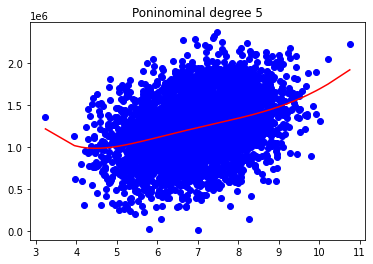

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 ... 4.77289822e+02
  2.23088774e+03 1.04273334e+04]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 ... 5.49028654e+02
  2.65762539e+03 1.28644883e+04]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 ... 1.71636804e+03
  1.10474749e+04 7.11075356e+04]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 ... 1.85360796e+03
  1.21624861e+04 7.98043983e+04]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 ... 4.55832467e+03
  3.74547212e+04 3.07756960e+05]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 ... 3.32790928e+03
  2.52763493e+04 1.91980544e+05]]
(4000, 7)
y_pred (4000,)
Score: 0.10911417857589178


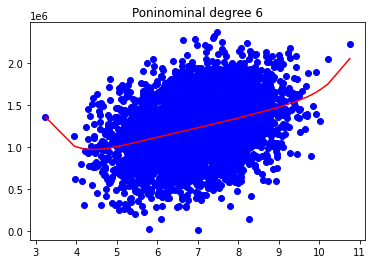

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 ... 2.23088774e+03
  1.04273334e+04 4.87381235e+04]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 ... 2.65762539e+03
  1.28644883e+04 6.22717785e+04]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 ... 1.10474749e+04
  7.11075356e+04 4.57686636e+05]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 ... 1.21624861e+04
  7.98043983e+04 5.23638173e+05]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 ... 3.74547212e+04
  3.07756960e+05 2.52876922e+06]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 ... 2.52763493e+04
  1.91980544e+05 1.45814290e+06]]
(4000, 8)
y_pred (4000,)
Score: 0.10949481246189019


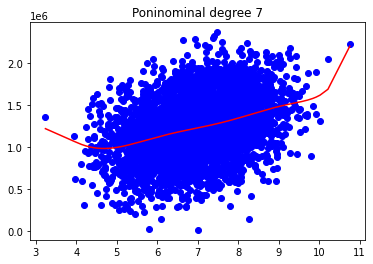

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 ... 1.04273334e+04
  4.87381235e+04 2.27805574e+05]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 ... 1.28644883e+04
  6.22717785e+04 3.01432463e+05]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 ... 7.11075356e+04
  4.57686636e+05 2.94591924e+06]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 ... 7.98043983e+04
  5.23638173e+05 3.43586246e+06]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 ... 3.07756960e+05
  2.52876922e+06 2.07783238e+07]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 ... 1.91980544e+05
  1.45814290e+06 1.10749802e+07]]
(4000, 9)
y_pred (4000,)
Score: 0.11000721598754915


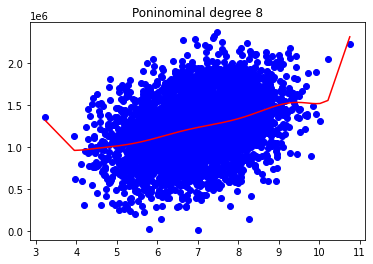

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 ... 4.87381235e+04
  2.27805574e+05 1.06478001e+06]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 ... 6.22717785e+04
  3.01432463e+05 1.45911249e+06]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 ... 4.57686636e+05
  2.94591924e+06 1.89615328e+07]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 ... 5.23638173e+05
  3.43586246e+06 2.25444810e+07]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 ... 2.52876922e+06
  2.07783238e+07 1.70730780e+08]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 ... 1.45814290e+06
  1.10749802e+07 8.41173973e+07]]
(4000, 10)
y_pred (4000,)
Score: 0.1102927777425936


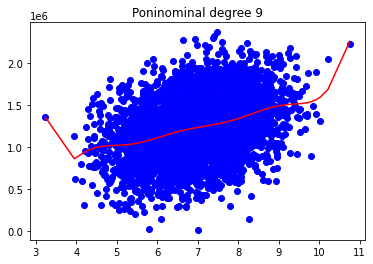

################
[[1.00000000e+00 4.67407356e+00 2.18469637e+01 ... 2.27805574e+05
  1.06478001e+06 4.97686011e+06]
 [1.00000000e+00 4.84059506e+00 2.34313605e+01 ... 3.01432463e+05
  1.45911249e+06 7.06297271e+06]
 [1.00000000e+00 6.43654196e+00 4.14290724e+01 ... 2.94591924e+06
  1.89615328e+07 1.22046701e+08]
 ...
 [1.00000000e+00 6.56152022e+00 4.30535475e+01 ... 3.43586246e+06
  2.25444810e+07 1.47926068e+08]
 [1.00000000e+00 8.21677347e+00 6.75153662e+01 ... 2.07783238e+07
  1.70730780e+08 1.40285614e+09]
 [1.00000000e+00 7.59526393e+00 5.76880341e+01 ... 1.10749802e+07
  8.41173973e+07 6.38893833e+08]]
(4000, 11)
y_pred (4000,)
Score: 0.11028903017392089


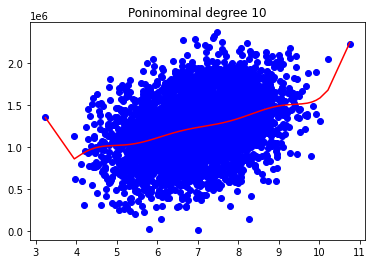

################
[[ 1.      3.42   11.6964]
 [ 1.      6.11   37.3321]
 [ 1.      3.1     9.61  ]
 ...
 [ 1.      3.41   11.6281]
 [ 1.      5.25   27.5625]
 [ 1.      4.44   19.7136]]
(4000, 3)
y_pred (4000,)
Score: 0.02770294204266943


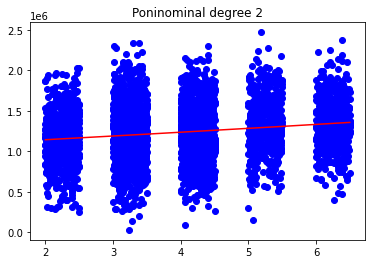

################
[[  1.         3.42      11.6964    40.001688]
 [  1.         6.11      37.3321   228.099131]
 [  1.         3.1        9.61      29.791   ]
 ...
 [  1.         3.41      11.6281    39.651821]
 [  1.         5.25      27.5625   144.703125]
 [  1.         4.44      19.7136    87.528384]]
(4000, 4)
y_pred (4000,)
Score: 0.02778860916173287


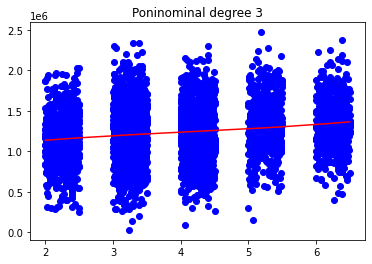

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 4.00016880e+01
  1.36805773e+02]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 2.28099131e+02
  1.39368569e+03]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 2.97910000e+01
  9.23521000e+01]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 3.96518210e+01
  1.35212710e+02]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 1.44703125e+02
  7.59691406e+02]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 8.75283840e+01
  3.88626025e+02]]
(4000, 5)
y_pred (4000,)
Score: 0.03219511989364765


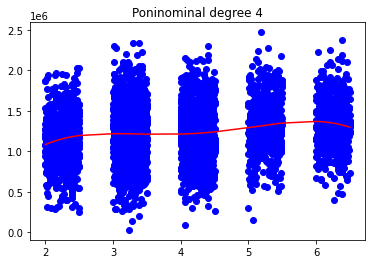

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 4.00016880e+01
  1.36805773e+02 4.67875744e+02]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 2.28099131e+02
  1.39368569e+03 8.51541957e+03]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 2.97910000e+01
  9.23521000e+01 2.86291510e+02]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 3.96518210e+01
  1.35212710e+02 4.61075340e+02]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 1.44703125e+02
  7.59691406e+02 3.98837988e+03]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 8.75283840e+01
  3.88626025e+02 1.72549955e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.0327757319716635


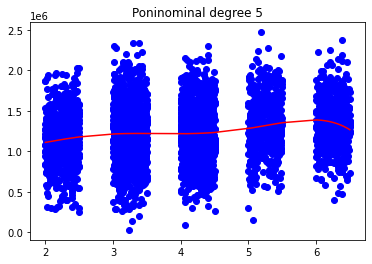

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 ... 1.36805773e+02
  4.67875744e+02 1.60013504e+03]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 ... 1.39368569e+03
  8.51541957e+03 5.20292136e+04]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 ... 9.23521000e+01
  2.86291510e+02 8.87503681e+02]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 ... 1.35212710e+02
  4.61075340e+02 1.57226691e+03]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 ... 7.59691406e+02
  3.98837988e+03 2.09389944e+04]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 ... 3.88626025e+02
  1.72549955e+03 7.66121801e+03]]
(4000, 7)
y_pred (4000,)
Score: 0.03375306023822122


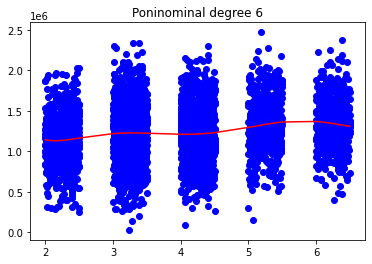

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 ... 4.67875744e+02
  1.60013504e+03 5.47246185e+03]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 ... 8.51541957e+03
  5.20292136e+04 3.17898495e+05]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 ... 2.86291510e+02
  8.87503681e+02 2.75126141e+03]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 ... 4.61075340e+02
  1.57226691e+03 5.36143016e+03]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 ... 3.98837988e+03
  2.09389944e+04 1.09929721e+05]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 ... 1.72549955e+03
  7.66121801e+03 3.40158079e+04]]
(4000, 8)
y_pred (4000,)
Score: 0.03375897755952284


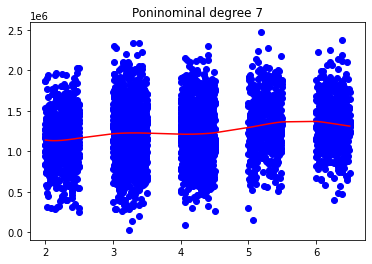

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 ... 1.60013504e+03
  5.47246185e+03 1.87158195e+04]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 ... 5.20292136e+04
  3.17898495e+05 1.94235980e+06]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 ... 8.87503681e+02
  2.75126141e+03 8.52891037e+03]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 ... 1.57226691e+03
  5.36143016e+03 1.82824768e+04]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 ... 2.09389944e+04
  1.09929721e+05 5.77131033e+05]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 ... 7.66121801e+03
  3.40158079e+04 1.51030187e+05]]
(4000, 9)
y_pred (4000,)
Score: 0.03376291330921488


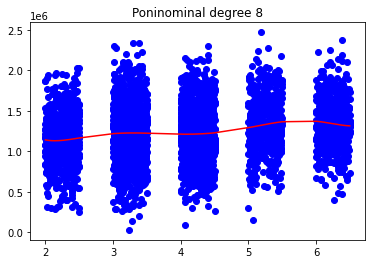

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 ... 5.47246185e+03
  1.87158195e+04 6.40081027e+04]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 ... 3.17898495e+05
  1.94235980e+06 1.18678184e+07]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 ... 2.75126141e+03
  8.52891037e+03 2.64396222e+04]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 ... 5.36143016e+03
  1.82824768e+04 6.23432460e+04]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 ... 1.09929721e+05
  5.77131033e+05 3.02993792e+06]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 ... 3.40158079e+04
  1.51030187e+05 6.70574032e+05]]
(4000, 10)
y_pred (4000,)
Score: 0.033899793182596616


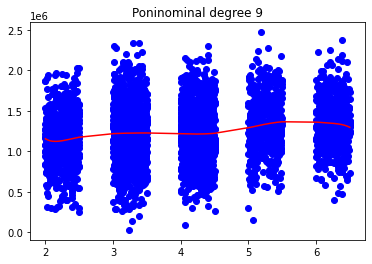

################
[[1.00000000e+00 3.42000000e+00 1.16964000e+01 ... 1.87158195e+04
  6.40081027e+04 2.18907711e+05]
 [1.00000000e+00 6.11000000e+00 3.73321000e+01 ... 1.94235980e+06
  1.18678184e+07 7.25123704e+07]
 [1.00000000e+00 3.10000000e+00 9.61000000e+00 ... 8.52891037e+03
  2.64396222e+04 8.19628287e+04]
 ...
 [1.00000000e+00 3.41000000e+00 1.16281000e+01 ... 1.82824768e+04
  6.23432460e+04 2.12590469e+05]
 [1.00000000e+00 5.25000000e+00 2.75625000e+01 ... 5.77131033e+05
  3.02993792e+06 1.59071741e+07]
 [1.00000000e+00 4.44000000e+00 1.97136000e+01 ... 1.51030187e+05
  6.70574032e+05 2.97734870e+06]]
(4000, 11)
y_pred (4000,)
Score: 0.033930680913706546


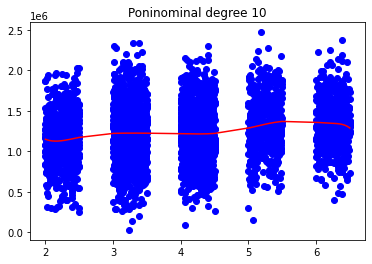

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.17155117384167962


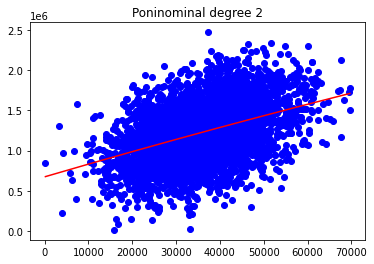

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 4.05876387e+13]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 4.54368938e+13]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 5.24509175e+13]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 3.03648027e+13]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 9.76970525e+13]]
(4000, 4)
y_pred (4000,)
Score: 0.1715959988744854


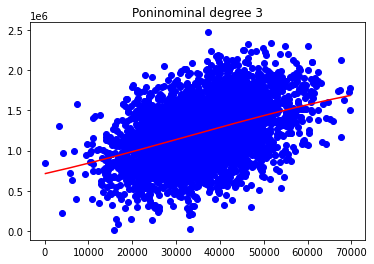

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 4.05876387e+13
  1.39484210e+18]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 4.54368938e+13
  1.62135524e+18]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 5.24509175e+13
  1.96337890e+18]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13
  7.15623153e+17]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 3.03648027e+13
  9.47313992e+17]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 9.76970525e+13
  4.49961423e+18]]
(4000, 5)
y_pred (4000,)
Score: 0.17157771459092763


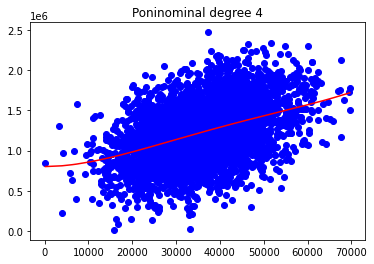

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 4.05876387e+13
  1.39484210e+18 4.79353948e+22]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 4.54368938e+13
  1.62135524e+18 5.78559094e+22]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 5.24509175e+13
  1.96337890e+18 7.34945523e+22]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 2.46044288e+13
  7.15623153e+17 2.08139966e+22]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 3.03648027e+13
  9.47313992e+17 2.95540797e+22]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 9.76970525e+13
  4.49961423e+18 2.07237862e+23]]
(4000, 6)
y_pred (4000,)
Score: 0.17083183171631533


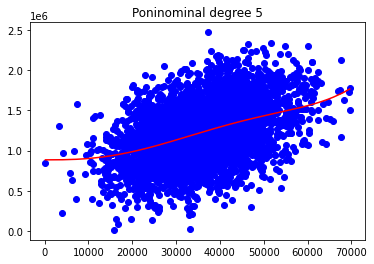

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 ... 1.39484210e+18
  4.79353948e+22 1.64735641e+27]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 ... 1.62135524e+18
  5.78559094e+22 2.06451132e+27]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 ... 1.96337890e+18
  7.34945523e+22 2.75109874e+27]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 7.15623153e+17
  2.08139966e+22 6.05377916e+26]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 ... 9.47313992e+17
  2.95540797e+22 9.22021245e+26]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 ... 4.49961423e+18
  2.07237862e+23 9.54471406e+27]]
(4000, 7)
y_pred (4000,)
Score: 0.16892658266851146


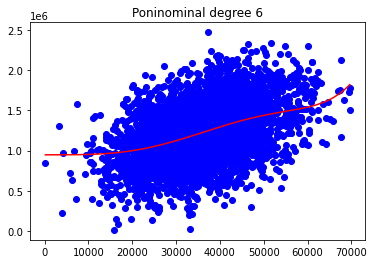

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 ... 4.79353948e+22
  1.64735641e+27 5.66133471e+31]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 ... 5.78559094e+22
  2.06451132e+27 7.36693459e+31]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 ... 7.34945523e+22
  2.75109874e+27 1.02981025e+32]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 2.08139966e+22
  6.05377916e+26 1.76074989e+31]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 ... 2.95540797e+22
  9.22021245e+26 2.87650025e+31]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 ... 2.07237862e+23
  9.54471406e+27 4.39599048e+32]]
(4000, 8)
y_pred (4000,)
Score: 0.16561859068783347


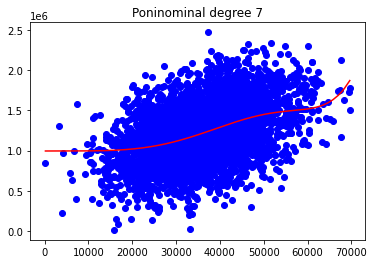

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 ... 1.64735641e+27
  5.66133471e+31 1.94558448e+36]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 ... 2.06451132e+27
  7.36693459e+31 2.62879281e+36]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 ... 2.75109874e+27
  1.02981025e+32 3.85485670e+36]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 6.05377916e+26
  1.76074989e+31 5.12116497e+35]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 ... 9.22021245e+26
  2.87650025e+31 8.97403800e+35]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 ... 9.54471406e+27
  4.39599048e+32 2.02465282e+37]]
(4000, 9)
y_pred (4000,)
Score: 0.1608245554511084


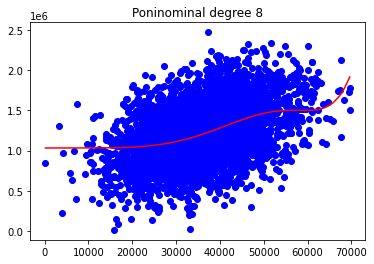

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 ... 5.66133471e+31
  1.94558448e+36 6.68623067e+40]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 ... 7.36693459e+31
  2.62879281e+36 9.38049817e+40]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 ... 1.02981025e+32
  3.85485670e+36 1.44297653e+41]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 1.76074989e+31
  5.12116497e+35 1.48949778e+40]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 ... 2.87650025e+31
  8.97403800e+35 2.79969932e+40]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 ... 4.39599048e+32
  2.02465282e+37 9.32490431e+41]]
(4000, 10)
y_pred (4000,)
Score: 0.1546408858032997


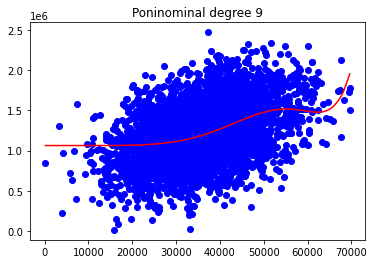

################
[[1.00000000e+00 3.43661801e+04 1.18103433e+09 ... 1.94558448e+36
  6.68623067e+40 2.29780208e+45]
 [1.00000000e+00 3.56836725e+04 1.27332448e+09 ... 2.62879281e+36
  9.38049817e+40 3.34730625e+45]
 [1.00000000e+00 3.74326893e+04 1.40120623e+09 ... 3.85485670e+36
  1.44297653e+41 5.40144922e+45]
 ...
 [1.00000000e+00 2.90851358e+04 8.45945124e+08 ... 5.12116497e+35
  1.48949778e+40 4.33222453e+44]
 [1.00000000e+00 3.11977654e+04 9.73300566e+08 ... 8.97403800e+35
  2.79969932e+40 8.73443627e+44]
 [1.00000000e+00 4.60568064e+04 2.12122942e+09 ... 2.02465282e+37
  9.32490431e+41 4.29475312e+46]]
(4000, 11)
y_pred (4000,)
Score: 0.1473005010942935


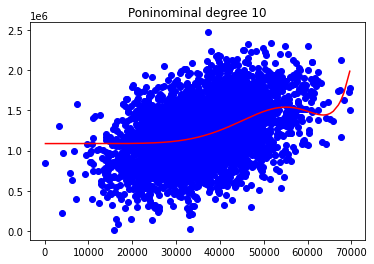

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12]]
(4000, 3)
y_pred (4000,)
Score: 1.0


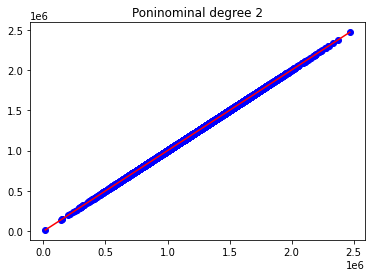

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 4.11064287e+18]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 3.92201954e+18]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 1.92597832e+16]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 5.06091441e+17]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 5.11865743e+18]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 2.52056730e+18]]
(4000, 4)
y_pred (4000,)
Score: 0.9999991824357879


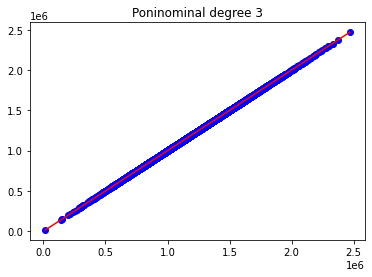

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 4.11064287e+18
  6.58485673e+24]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 3.92201954e+18
  6.18509447e+24]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 1.92597832e+16
  5.16260059e+21]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 5.06091441e+17
  4.03309690e+23]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 5.11865743e+18
  8.82147932e+24]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 2.52056730e+18
  3.43029178e+24]]
(4000, 5)
y_pred (4000,)
Score: 0.999285339347921


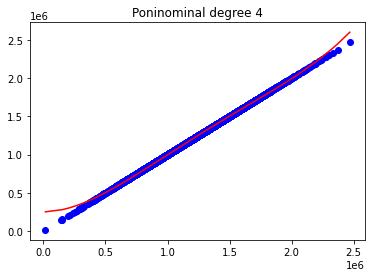

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 4.11064287e+18
  6.58485673e+24 1.05483107e+31]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 3.92201954e+18
  6.18509447e+24 9.75400382e+30]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 1.92597832e+16
  5.16260059e+21 1.38383929e+27]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 5.06091441e+17
  4.03309690e+23 3.21401812e+29]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 5.11865743e+18
  8.82147932e+24 1.52029118e+31]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 2.52056730e+18
  3.43029178e+24 4.66835451e+30]]
(4000, 6)
y_pred (4000,)
Score: 0.9948279230023469


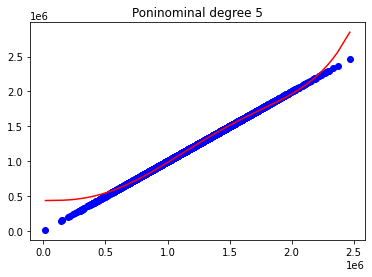

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 ... 6.58485673e+24
  1.05483107e+31 1.68973848e+37]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 ... 6.18509447e+24
  9.75400382e+30 1.53822373e+37]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 ... 5.16260059e+21
  1.38383929e+27 3.70939250e+32]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 ... 4.03309690e+23
  3.21401812e+29 2.56128547e+35]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 ... 8.82147932e+24
  1.52029118e+31 2.62006539e+37]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 ... 3.43029178e+24
  4.66835451e+30 6.35325950e+36]]
(4000, 7)
y_pred (4000,)
Score: 0.9832536597954121


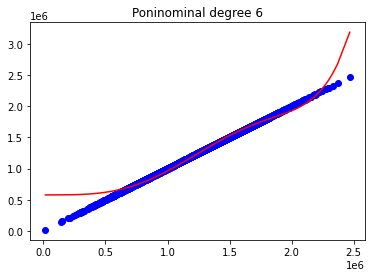

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 ... 1.05483107e+31
  1.68973848e+37 2.70679944e+43]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 ... 9.75400382e+30
  1.53822373e+37 2.42580613e+43]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 ... 1.38383929e+27
  3.70939250e+32 9.94305682e+37]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 ... 3.21401812e+29
  2.56128547e+35 2.04111582e+41]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 ... 1.52029118e+31
  2.62006539e+37 4.51541307e+43]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 ... 4.66835451e+30
  6.35325950e+36 8.64628129e+42]]
(4000, 8)
y_pred (4000,)
Score: 0.9623695010842065


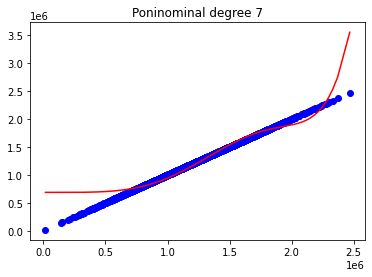

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 ... 1.68973848e+37
  2.70679944e+43 4.33603381e+49]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 ... 1.53822373e+37
  2.42580613e+43 3.82553936e+49]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 ... 3.70939250e+32
  9.94305682e+37 2.66524448e+43]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 ... 2.56128547e+35
  2.04111582e+41 1.62658706e+47]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 ... 2.62006539e+37
  4.51541307e+43 7.78184974e+49]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 ... 6.35325950e+36
  8.64628129e+42 1.17669017e+49]]
(4000, 9)
y_pred (4000,)
Score: 0.931531375215239


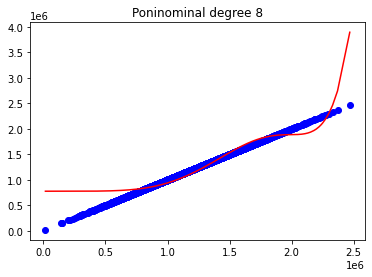

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 ... 2.70679944e+43
  4.33603381e+49 6.94591145e+55]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 ... 2.42580613e+43
  3.82553936e+49 6.03294351e+55]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 ... 9.94305682e+37
  2.66524448e+43 7.14420955e+48]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 ... 2.04111582e+41
  1.62658706e+47 1.29624465e+53]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 ... 4.51541307e+43
  7.78184974e+49 1.34112172e+56]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 ... 8.64628129e+42
  1.17669017e+49 1.60138181e+55]]
(4000, 10)
y_pred (4000,)
Score: 0.8915042919533618


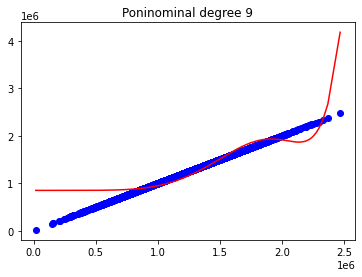

################
[[1.00000000e+00 1.60190436e+06 2.56609757e+12 ... 4.33603381e+49
  6.94591145e+55 1.11266858e+62]
 [1.00000000e+00 1.57701776e+06 2.48698502e+12 ... 3.82553936e+49
  6.03294351e+55 9.51405905e+61]
 [1.00000000e+00 2.68050815e+05 7.18512393e+10 ... 2.66524448e+43
  7.14420955e+48 1.91501119e+54]
 ...
 [1.00000000e+00 7.96910711e+05 6.35066682e+11 ... 1.62658706e+47
  1.29624465e+53 1.03299125e+59]
 [1.00000000e+00 1.72339709e+06 2.97009753e+12 ... 7.78184974e+49
  1.34112172e+56 2.31128527e+62]
 [1.00000000e+00 1.36092053e+06 1.85210469e+12 ... 1.17669017e+49
  1.60138181e+55 2.17935339e+61]]
(4000, 11)
y_pred (4000,)
Score: 0.8440583452542207


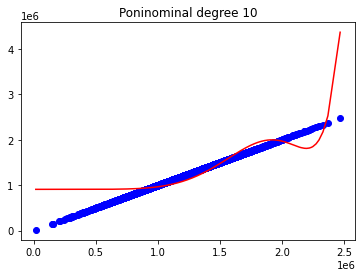

In [9]:
#Me calcula la regresión no lineal entre 2 y 10 grados y me va guardando los score
#El X se lo paso en type object Dataframe para que el for me coja la posición [element]
degree_min = 2
degree_max = 10
scores = []

for element in df.columns:
    X_train, X_test, y_train, y_test = train_test_split(X[element].values,y,test_size=0.2)
    #En cada iteración toma una columna de X y parte el conjunto de datos.
    for degree in range(degree_min,degree_max+1):
        print("################")
        polinominal_model = PolynomialFeatures(degree) 
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

        #######
        print(X_poly)
        print(X_poly.shape)

        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)

        print("y_pred", y_pred.shape)
        print("Score:", r2_score(y_train, y_pred))

        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
        plt.scatter(X_train_to_show, y_train_to_show, color='b')
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red')
        plt.title("Poninominal degree " + str(degree))
        plt.show()
  

SVR

In [10]:
X_1=df.iloc[:,3]

In [11]:
X_1

0       4.09
1       3.09
2       5.13
3       3.26
4       4.23
        ... 
4995    3.46
4996    4.02
4997    2.13
4998    5.44
4999    4.07
Name: Avg. Area Number of Bedrooms, Length: 5000, dtype: float64

In [12]:
X_1=np.array(X_1)
X_1

array([4.09, 3.09, 5.13, ..., 2.13, 5.44, 4.07])

In [13]:
X_1.shape

(5000,)

In [14]:
X_1=X_1.reshape(-1,1)

In [15]:
y

array([1059033.55787012, 1505890.91484695, 1058987.98787608, ...,
       1030729.58315229, 1198656.87240769, 1298950.48026696])

In [16]:
y.shape

(5000,)

Para ejecutar este código solo lo puedo hacer comparando una columna para X con el tarjet y

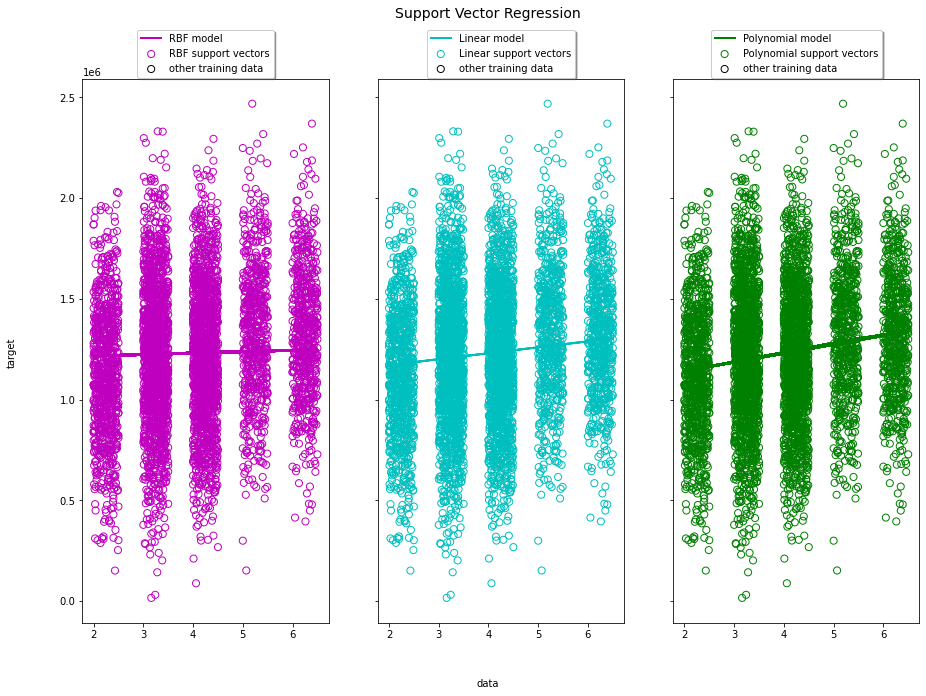

In [17]:
import sklearn
import numpy as np
from sklearn.svm import SVR
import matplotlib.pyplot as plt


svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1, coef0=1)

lw = 2
svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    model = svr.fit(X_1,y)
    y_prediction= model.predict(X_1)
    axes[ix].plot(X_1, y_prediction, color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
    axes[ix].scatter(X_1[svr.support_], y[svr.support_], facecolor="none",
                     edgecolor=model_color[ix], s=50,
                     label='{} support vectors'.format(kernel_label[ix]))
    axes[ix].scatter(X_1[np.setdiff1d(np.arange(len(X_1)), svr.support_)],
                     y[np.setdiff1d(np.arange(len(X_1)), svr.support_)],
                     facecolor="none", edgecolor="k", s=50,
                     label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)

fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()

MI X

In [18]:
df_2=df.iloc[:,0:5]
df_2

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


MI Y

In [19]:
df_1=df.iloc[:,5]

In [20]:
df_1

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

In [21]:
df_1=np.array(df_1)

PASAMOS TODAS LAS COLUMNAS DE MI X EN UN FOR PARA QUE PARTA LOS CONJUNTOS DE DATOS DE CADA COLUMNA.
EN OTRO FOR INTERNO LE PASAMOS A CADA COLUMNA LOS TRES KELNERS PARA QUE ME DE RESULTADOS.
ME DA LOS MEJORES SCORT PARA CADA KELNER.

##############################
(4000, 1)
y_pred (4000,)
score: 0.0013987718616444988
##############################
(4000, 1)
y_pred (4000,)
score: 0.4103432657172088
##############################
(4000, 1)
y_pred (4000,)
score: 0.3980590755844994
##############################
(4000, 1)
y_pred (4000,)
score: 0.0007547425788742013
##############################
(4000, 1)
y_pred (4000,)
score: 0.0037467565701995165
##############################
(4000, 1)
y_pred (4000,)
score: 0.19657574645590037
##############################
(4000, 1)
y_pred (4000,)
score: 0.00037612026839206614
##############################
(4000, 1)
y_pred (4000,)
score: 0.002064482733753925
##############################
(4000, 1)
y_pred (4000,)
score: 0.11669400480598813
##############################
(4000, 1)
y_pred (4000,)
score: 0.00011435613348176332
##############################
(4000, 1)
y_pred (4000,)
score: 0.0007883916330201357
##############################
(4000, 1)
y_pred (4000,)
score: 0.025234835

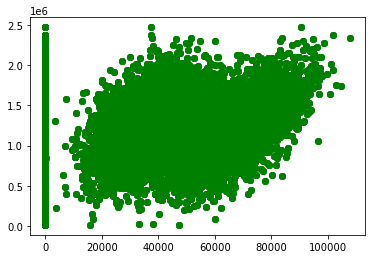

In [22]:
import sklearn
from sklearn import svm
from sklearn.svm import SVR

for element in df_2.columns:
     X_train, X_test, y_train, y_test = train_test_split(df_2[element].values.reshape(-1,1),df_1,                 test_size=0.2,random_state=7)
     scores=[]
     kernel_label= ["rbf","linear","poly"]
     for kern in kernel_label:
          print("##############################")
          print(X_train.shape)
          model=SVR(kernel=kern)
          model.fit(X_train,y_train)
          y_pred=model.predict(X_train)

          score= r2_score(y_train,y_pred)
          scores.append(score)
          print("y_pred",y_pred.shape)
          print("score:",score)
          X_train_to_show, y_train_to_show=zip(*sorted(zip(X_train,y_train)))
          plt.scatter(X_train_to_show, y_train_to_show,color="g")
          X_train_to_show, y_pred=zip(*sorted(zip(X_train,y_pred)))

In [23]:
df_2.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population'],
      dtype='object')

In [24]:
df_2["Avg. Area Number of Bedrooms"] = np.round(df["Avg. Area Number of Bedrooms"],decimals = 0)
df_2["Avg. Area Number of Bedrooms"] = df_2["Avg. Area Number of Bedrooms"].astype(int)


In [25]:
df_2

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4,23086.800503
1,79248.642455,6.002900,6.730821,3,40173.072174
2,61287.067179,5.865890,8.512727,5,36882.159400
3,63345.240046,7.188236,5.586729,3,34310.242831
4,59982.197226,5.040555,7.839388,4,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3,22837.361035
4996,78491.275435,6.999135,6.576763,4,25616.115489
4997,63390.686886,7.250591,4.805081,2,33266.145490
4998,68001.331235,5.534388,7.130144,5,42625.620156


In [26]:
df_3=df_2.iloc[:,3]

NUESTRA Y

In [27]:
df_3

0       4
1       3
2       5
3       3
4       4
       ..
4995    3
4996    4
4997    2
4998    5
4999    4
Name: Avg. Area Number of Bedrooms, Length: 5000, dtype: int32

In [28]:
df_2=df_2.copy()

NUESTRA X

In [29]:
df_4=df_2.drop(['Avg. Area Number of Bedrooms'],1)


In [30]:
df_4

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Area Population
0,79545.458574,5.682861,7.009188,23086.800503
1,79248.642455,6.002900,6.730821,40173.072174
2,61287.067179,5.865890,8.512727,36882.159400
3,63345.240046,7.188236,5.586729,34310.242831
4,59982.197226,5.040555,7.839388,26354.109472
...,...,...,...,...
4995,60567.944140,7.830362,6.137356,22837.361035
4996,78491.275435,6.999135,6.576763,25616.115489
4997,63390.686886,7.250591,4.805081,33266.145490
4998,68001.331235,5.534388,7.130144,42625.620156


EN ESTE MODELO PASAMOS COLUMNA A COLUMNA DE NUESTRA X Y CON LA FUNCION LE PASAMOS VARIOS PARAMETROS DE C, GAMMA Y KELNERS PARA QUE NOS SAQUE EL MEJOR SCORE DE X_TEST

In [31]:
from sklearn import svm
from sklearn.svm import SVC
import scipy.io as sio

In [44]:
  def data4_params( X_train, y_train):
        C_cands = [0.01, 0.03, 0.1, 0.3, 1, 3, 10, 30]
        gamma_cands = [0.01, 0.03, 0.1, 0.3, 1, 3, 10, 30]
        kernel_cands=["rbf","poly"] #"linear","poly"
        max_score = -1
        C_pick = -1
        gamma_pick = -1
        kernel_pick= -1
        

        for C in C_cands:
            for gamma in gamma_cands:
                for kernel in kernel_cands:
                    clf = svm.SVC(C=C, kernel= kernel, gamma=gamma)
                    clf.fit(X_train, y_train)
                    score = clf.score(X_test, y_test)
                    if score > max_score:
                        max_score = score
                        C_pick = C
                        gamma_pick = gamma
                        kernel_pick=kernel
        return C_pick, gamma_pick,kernel_pick
                            

In [45]:
for element in df_4.columns:
    X_train, X_test, y_train, y_test = train_test_split(df_4[element].values.reshape(-1,1),df_3,            test_size=0.2,random_state=7)
    C, gamma,kernel= data4_params( X_train, y_train)
    print("C", C)
    print("gamma", gamma)
    print("Kernel:",kernel)
    clf = svm.SVC(C=C, kernel=kernel, gamma=gamma)
    clf.fit(X_train, y_train)
    print ('score:', clf.score(X_test, y_test))
